In [1]:
%matplotlib inline 
import json
import numpy as np
import operator
import os
import pandas
import pylab as plt
import random
from ase.data import reference_states, atomic_numbers
from sklearn.neighbors.kde import KernelDensity
from pyiron.project import Project

/scratch/janssen/pyiron_meltingpoint_fe/.snakemake/conda/1c1e366b/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.kde module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
import matplotlib as mpl
mpl.rc('font', family='Times New Roman')
plt.rcParams["mathtext.fontset"] = "stix"

In [3]:
from pyiron.thermodynamics.interfacemethod import freeze_one_half, remove_selective_dynamics, set_server, create_job_template, fix_iso, fix_z_dir, half_velocity, minimize_pos, minimize_vol, next_calc, npt_solid, npt_liquid, next_step_funct, round_temperature_next, strain_circle, analyse_minimized_structure, get_press, get_center_point, get_strain_lst, get_nve_job_name, plot_solid_liquid_ratio, ratio_selection, plot_equilibration, plot_melting_point_prediction, calc_temp_iteration, get_initial_melting_temperature_guess, validate_convergence, initialise_iterators, get_voronoi_volume, check_for_holes

In [4]:
pr = Project('melting')

In [5]:
input_file = os.path.join(pr.path, 'input.json')
output_file = os.path.join(pr.path, 'output.json')

In [6]:
# Parameters
input_file = "input.json"
output_file = "output.json"


In [7]:
pr.job_table()

""


In [8]:
if os.path.exists(input_file) and os.stat(input_file).st_size != 0:
    with open(input_file, 'r') as f:
        input_dict = json.load(f)
else:
    input_dict = {
        "config": [
            "pair_style morse 9.97749\n",
            "pair_coeff * * 0.4174 1.3885 2.845\n"
        ],
        "species": ["Al"],
        "element": "Al"
    }


In [9]:
input_dict

{'config': ['pair_style eam/alloy \n', 'pair_coeff * * Fe-C-Bec07.eam Fe C\n'],
 'filename': './examples/bccFe/Fe-C-Bec07.eam',
 'species': ['Fe', 'C'],
 'element': 'Fe',
 'cpu_cores': 8}

In [10]:
pot_dict = input_dict.copy()

In [11]:
if 'model' not in pot_dict.keys():
    pot_dict['model'] = 'Lammps'
if 'name' not in pot_dict.keys():
    pot_dict['name'] = 'CustomPotential'
if 'filename' not in pot_dict.keys():
    pot_path = []
else:
    pot_path = [os.path.abspath(pot_dict['filename'])]
potential = pandas.DataFrame({'Config': [pot_dict['config']],
                             'Filename': [pot_path],
                             'Model': [pot_dict['model']],
                             'Name': [pot_dict['name']],
                             'Species': [pot_dict['species']]
                             })

In [12]:
project_parameter = {
    'project': pr,
    'run_time_steps': 50000,
    'nvt_run_time_steps': 10000,
    'nve_run_time_steps': 10000,
    'temperature_left': 0,
    'temperature_right': 1000,
    'strain_run_time_steps': 1000,
    'convergence_criterion': 1,
    'potential': potential,
    'cpu_cores': 1, 
    'job_type': pr.job_type.Lammps,
    'enable_h5md': False,
    'points': 21,
    'boundary_value': 0.25,
    'ratio_boundary': 0.25,
    'timestep_lst': [2, 2, 1],
    'fit_range_lst': [0.05, 0.01, 0.01],
    'nve_run_time_steps_lst': [25000, 20000, 50000],
    'number_of_atoms': 8000, 
}

In [13]:
for k in input_dict.keys():
    project_parameter[k] = input_dict[k]

In [14]:
if 'crystalstructure' not in project_parameter.keys():
    project_parameter['crystalstructure'] = reference_states[atomic_numbers[project_parameter['element']]]['symmetry']

In [15]:
if 'seed' not in project_parameter.keys():
    project_parameter['seed'] = random.randint(0,99999)
project_parameter['seed']

86046

In [16]:
# Values from a previous calculation can be inserted here to reproduce the results 
step_dict = {}
if os.path.exists(output_file):
    with open(output_file, 'r') as f:
        step_dict_str = json.load(f)
    for k,v in step_dict_str.items():
        step_dict[int(k)] = v
step_dict

{}

# From here on the notebook is automated - no change required !

In [17]:
step_count = 0
temperature_next = None
enable_iteration = True
convergence_goal_achieved = False

In [18]:
pr = project_parameter['project']

In [19]:
if 'lattice_constant' in project_parameter.keys():
    basis = pr.create_structure(project_parameter['element'], project_parameter['crystalstructure'].lower(), project_parameter['lattice_constant'])
elif project_parameter['crystalstructure'] == 'hcp':
    basis = pr.create_ase_bulk(project_parameter['element'], project_parameter['crystalstructure'].lower(), cubic=False)
else:
    basis = pr.create_ase_bulk(project_parameter['element'], project_parameter['crystalstructure'].lower(), cubic=True)
basis_lst = [basis.repeat([i, i, i]) for i in range(5,30)]
basis = basis_lst[np.argmin([np.abs(len(b)-project_parameter['number_of_atoms']/2) for b in basis_lst])]

In [20]:
basis.analyse_ovito_cna_adaptive()

{'CommonNeighborAnalysis.counts.BCC': 4394, 'CommonNeighborAnalysis.counts.FCC': 0, 'CommonNeighborAnalysis.counts.HCP': 0, 'CommonNeighborAnalysis.counts.ICO': 0, 'CommonNeighborAnalysis.counts.OTHER': 0}

In [21]:
basis.plot3d()

_ColormakerRegistry()

NGLWidget()

In [22]:
# pr.remove_jobs(recursive=True)

In [23]:
timestep_iter, fit_range_iter, nve_run_time_steps_iter = initialise_iterators(project_parameter)
timestep = next(timestep_iter)
fit_range = next(fit_range_iter)
nve_run_time_steps = next(nve_run_time_steps_iter)

In [24]:
pr.job_table()

""


# Step 1: set up the solid sample and roughly estimate a melting point

In [25]:
ham_minimize_pos= minimize_pos(
    structure=basis, 
    project_parameter=project_parameter
)

The job minimize_pos was saved and received the ID: 1


In [26]:
ham_minimize_vol = minimize_vol(
    structure=ham_minimize_pos.get_structure(), 
    project_parameter=project_parameter
)

The job minimize_vol was saved and received the ID: 2


In [27]:
temperature_next, structure_left = get_initial_melting_temperature_guess(
    project_parameter=project_parameter, 
    ham_minimize_vol=ham_minimize_vol, 
    temperature_next=temperature_next
)

The job temp_heating_1000 was saved and received the ID: 3


The job temp_heating_2000 was saved and received the ID: 4


The job temp_heating_1500_0 was saved and received the ID: 5


The job temp_heating_1750_0 was saved and received the ID: 6


The job temp_heating_1625_0 was saved and received the ID: 7


The job temp_heating_1687_5 was saved and received the ID: 8


The job temp_heating_1718_75 was saved and received the ID: 9


The job temp_heating_1734_375 was saved and received the ID: 10


The job temp_heating_1726_5625 was saved and received the ID: 11


In [28]:
temperature_next   # +/- 100K 

1727

In [29]:
if step_count in step_dict.keys():
    temperature_next = step_dict[step_count]['temperature_next']
else: 
    step_dict[step_count]= {'temperature_next': temperature_next}

In [30]:
step_dict

{0: {'temperature_next': 1727}}

# Step 2: set up the interface structure

The job ham_npt_solid_1727 was saved and received the ID: 12


The job ham_npt_liquid_high_2727 was saved and received the ID: 13


The job ham_npt_liquid_low_1727 was saved and received the ID: 14


2020-05-04 07:45:27,988 - pyiron_log - WARNING - Job 'ham_nve_0_95_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1727_0 was saved and received the ID: 15


2020-05-04 07:46:33,254 - pyiron_log - WARNING - Job 'ham_nve_0_955_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1727_0 was saved and received the ID: 16


2020-05-04 07:47:37,877 - pyiron_log - WARNING - Job 'ham_nve_0_96_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1727_0 was saved and received the ID: 17


2020-05-04 07:48:42,642 - pyiron_log - WARNING - Job 'ham_nve_0_965_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_965_1727_0 was saved and received the ID: 18


2020-05-04 07:49:47,666 - pyiron_log - WARNING - Job 'ham_nve_0_97_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_97_1727_0 was saved and received the ID: 19


2020-05-04 07:50:52,673 - pyiron_log - WARNING - Job 'ham_nve_0_975_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_975_1727_0 was saved and received the ID: 20


2020-05-04 07:51:57,139 - pyiron_log - WARNING - Job 'ham_nve_0_98_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_98_1727_0 was saved and received the ID: 21


2020-05-04 07:53:00,673 - pyiron_log - WARNING - Job 'ham_nve_0_985_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_985_1727_0 was saved and received the ID: 22


2020-05-04 07:54:03,866 - pyiron_log - WARNING - Job 'ham_nve_0_99_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_99_1727_0 was saved and received the ID: 23


2020-05-04 07:55:06,650 - pyiron_log - WARNING - Job 'ham_nve_0_995_1727_0' does not exist and cannot be loaded


The job ham_nvt_0_995_1727_0 was saved and received the ID: 24


2020-05-04 07:56:08,965 - pyiron_log - WARNING - Job 'ham_nve_1_0_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_0_1727_0 was saved and received the ID: 25


2020-05-04 07:57:11,945 - pyiron_log - WARNING - Job 'ham_nve_1_005_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_005_1727_0 was saved and received the ID: 26


2020-05-04 07:58:14,289 - pyiron_log - WARNING - Job 'ham_nve_1_01_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_01_1727_0 was saved and received the ID: 27


2020-05-04 07:59:16,524 - pyiron_log - WARNING - Job 'ham_nve_1_015_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_015_1727_0 was saved and received the ID: 28


2020-05-04 08:00:18,118 - pyiron_log - WARNING - Job 'ham_nve_1_02_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_02_1727_0 was saved and received the ID: 29


2020-05-04 08:01:19,446 - pyiron_log - WARNING - Job 'ham_nve_1_025_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_025_1727_0 was saved and received the ID: 30


2020-05-04 08:02:20,547 - pyiron_log - WARNING - Job 'ham_nve_1_03_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_03_1727_0 was saved and received the ID: 31


2020-05-04 08:03:21,252 - pyiron_log - WARNING - Job 'ham_nve_1_035_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_035_1727_0 was saved and received the ID: 32


2020-05-04 08:04:20,530 - pyiron_log - WARNING - Job 'ham_nve_1_04_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_04_1727_0 was saved and received the ID: 33


2020-05-04 08:05:20,426 - pyiron_log - WARNING - Job 'ham_nve_1_045_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_045_1727_0 was saved and received the ID: 34


2020-05-04 08:06:20,657 - pyiron_log - WARNING - Job 'ham_nve_1_05_1727_0' does not exist and cannot be loaded


The job ham_nvt_1_05_1727_0 was saved and received the ID: 35


The job ham_nve_0_95_1727_0 was saved and received the ID: 36


The job ham_nve_0_955_1727_0 was saved and received the ID: 37


The job ham_nve_0_96_1727_0 was saved and received the ID: 38


The job ham_nve_0_965_1727_0 was saved and received the ID: 39


The job ham_nve_0_97_1727_0 was saved and received the ID: 40


The job ham_nve_0_975_1727_0 was saved and received the ID: 41


The job ham_nve_0_98_1727_0 was saved and received the ID: 42


The job ham_nve_0_985_1727_0 was saved and received the ID: 43


The job ham_nve_0_99_1727_0 was saved and received the ID: 44


The job ham_nve_0_995_1727_0 was saved and received the ID: 45


The job ham_nve_1_0_1727_0 was saved and received the ID: 46


The job ham_nve_1_005_1727_0 was saved and received the ID: 47


The job ham_nve_1_01_1727_0 was saved and received the ID: 48


The job ham_nve_1_015_1727_0 was saved and received the ID: 49


The job ham_nve_1_02_1727_0 was saved and received the ID: 50


The job ham_nve_1_025_1727_0 was saved and received the ID: 51


The job ham_nve_1_03_1727_0 was saved and received the ID: 52


The job ham_nve_1_035_1727_0 was saved and received the ID: 53


The job ham_nve_1_04_1727_0 was saved and received the ID: 54


The job ham_nve_1_045_1727_0 was saved and received the ID: 55


The job ham_nve_1_05_1727_0 was saved and received the ID: 56


findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


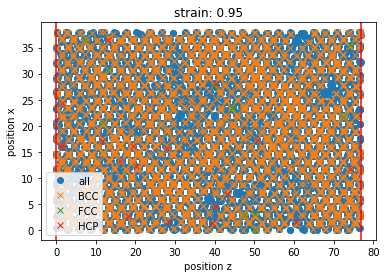

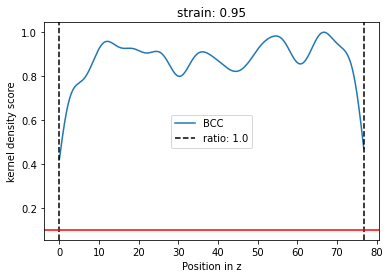

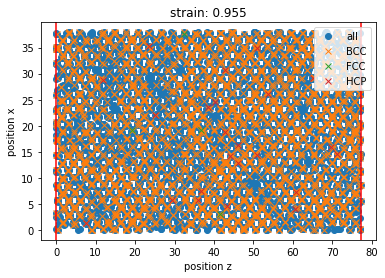

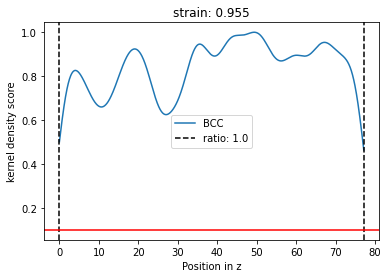

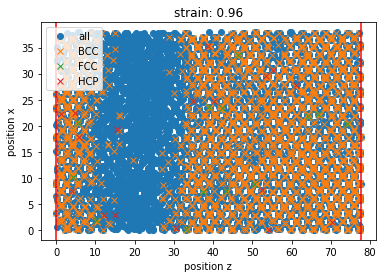

...

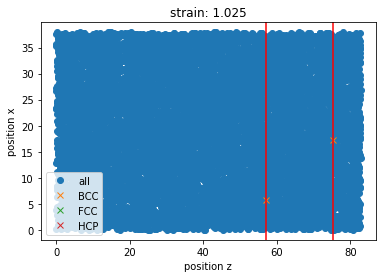

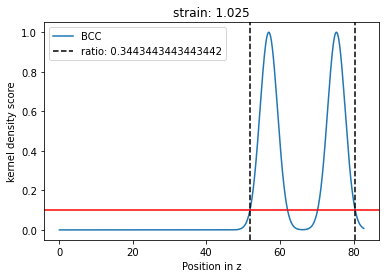

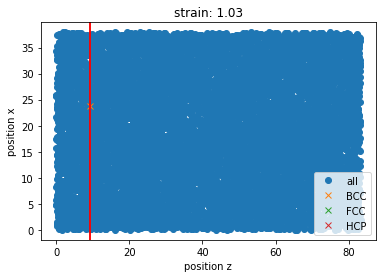

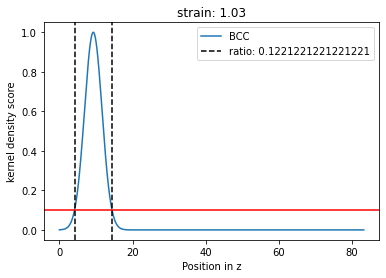

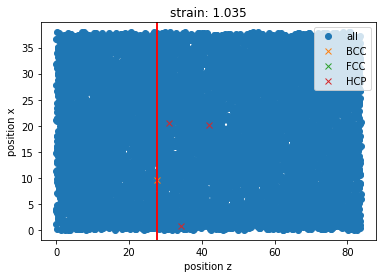

No handles with labels found to put in legend.


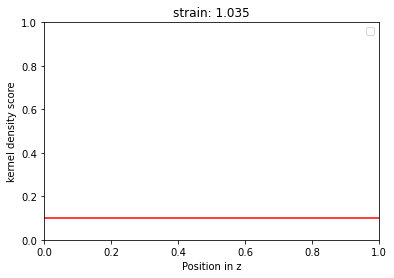

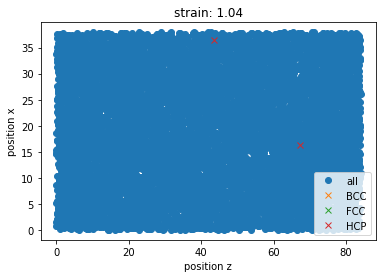

No handles with labels found to put in legend.


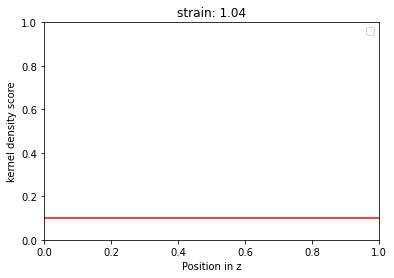

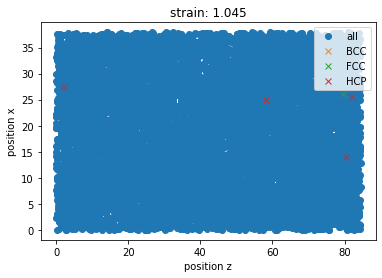

No handles with labels found to put in legend.


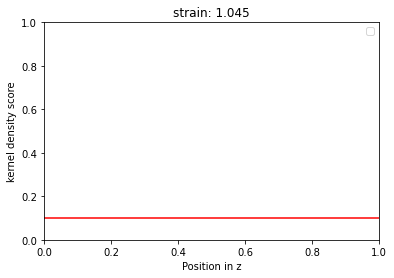

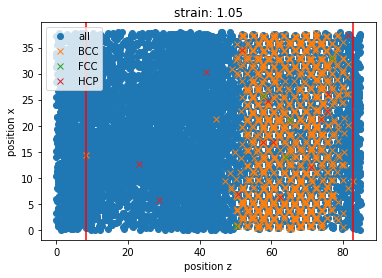

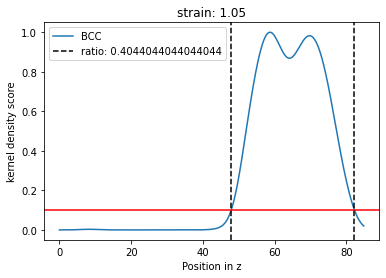

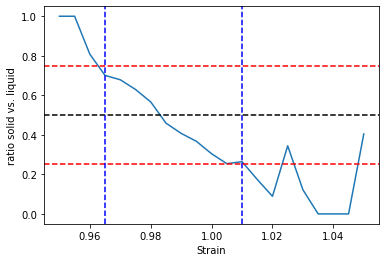

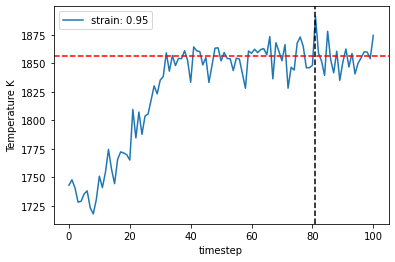

...

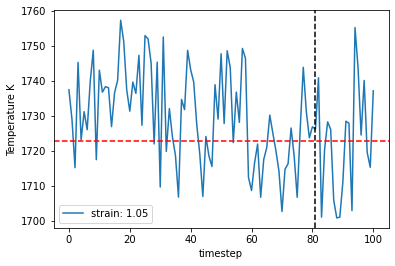

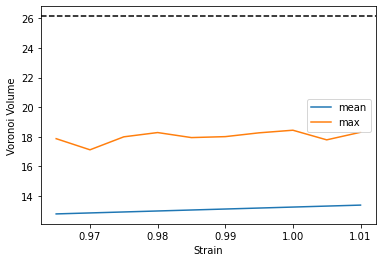

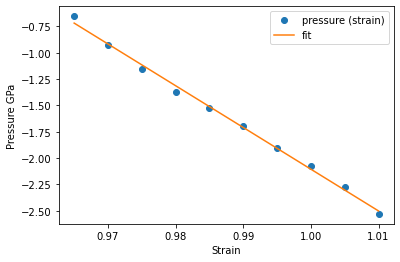

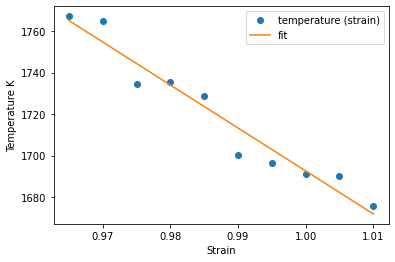

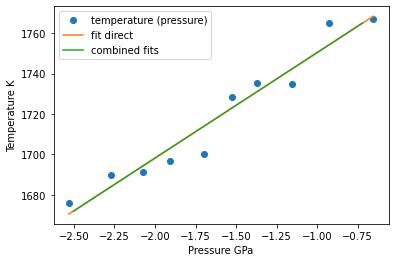

1802.5147857215081 1802.7469108023417


In [31]:
temperature_next, temperature_mean, temperature_left, temperature_right, strain_result_lst, pressure_result_lst = calc_temp_iteration(
        basis=ham_minimize_vol.get_structure().repeat([1,1,2]), 
        temperature_next=temperature_next, 
        project_parameter=project_parameter,
        timestep = timestep,
        nve_run_time_steps=nve_run_time_steps, 
        fit_range=fit_range,  
        center=None,
        debug_plot=True)

In [32]:
temperature_next, temperature_mean, temperature_left, temperature_right

(1802.5147857215081, 1721.5322155508406, 1698.693654634891, 1744.3707764667902)

# Step 3: run NVT and NVE MD

In [33]:
output = validate_convergence(
    pr=pr,
    temperature_left=temperature_left,
    temperature_next=temperature_next,
    temperature_right=temperature_right,
    enable_iteration=enable_iteration,
    timestep_iter=timestep_iter,
    timestep_lst=project_parameter['timestep_lst'],
    timestep=timestep,
    fit_range_iter=fit_range_iter,
    fit_range_lst=project_parameter['fit_range_lst'],
    fit_range=fit_range,
    nve_run_time_steps_iter=nve_run_time_steps_iter,
    nve_run_time_steps_lst=project_parameter['nve_run_time_steps_lst'],
    nve_run_time_steps=nve_run_time_steps,
    strain_result_lst=strain_result_lst,
    pressure_result_lst=pressure_result_lst,
    step_count=step_count,
    step_dict=step_dict,
    boundary_value=project_parameter['boundary_value'],
    ratio_boundary=project_parameter['ratio_boundary'],
    convergence_goal=project_parameter['convergence_criterion'],
    output_file=output_file
)
convergence_goal_achieved, enable_iteration, step_count, step_dict, timestep, fit_range, nve_run_time_steps, boundary_value, ratio_boundary, temperature_next, center = output

In [34]:
step_dict[step_count]

{'timestep': 2,
 'fit_range': 0.05,
 'nve_run_time_steps': 25000,
 'boundary_value': 0.25,
 'ratio_boundary': 0.25,
 'temperature_next': 1802.5147857215081,
 'center': 0.95}

In [35]:
convergence_goal_achieved

False

# Step 4: full cycle, predict the final melting point

The job ham_npt_solid_1802_51 was saved and received the ID: 57


The job ham_npt_liquid_high_2802_51 was saved and received the ID: 58


The job ham_npt_liquid_low_1802_51 was saved and received the ID: 59


2020-05-04 09:15:25,032 - pyiron_log - WARNING - Job 'ham_nve_0_9_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_9_1802_51_0 was saved and received the ID: 60


2020-05-04 09:16:31,995 - pyiron_log - WARNING - Job 'ham_nve_0_905_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_905_1802_51_0 was saved and received the ID: 61


2020-05-04 09:17:38,359 - pyiron_log - WARNING - Job 'ham_nve_0_91_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_91_1802_51_0 was saved and received the ID: 62


2020-05-04 09:18:44,556 - pyiron_log - WARNING - Job 'ham_nve_0_915_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_915_1802_51_0 was saved and received the ID: 63


2020-05-04 09:19:51,619 - pyiron_log - WARNING - Job 'ham_nve_0_92_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_92_1802_51_0 was saved and received the ID: 64


2020-05-04 09:20:57,674 - pyiron_log - WARNING - Job 'ham_nve_0_925_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_925_1802_51_0 was saved and received the ID: 65


2020-05-04 09:22:04,277 - pyiron_log - WARNING - Job 'ham_nve_0_93_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_93_1802_51_0 was saved and received the ID: 66


2020-05-04 09:23:10,558 - pyiron_log - WARNING - Job 'ham_nve_0_935_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_935_1802_51_0 was saved and received the ID: 67


2020-05-04 09:24:16,214 - pyiron_log - WARNING - Job 'ham_nve_0_94_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_94_1802_51_0 was saved and received the ID: 68


2020-05-04 09:25:22,802 - pyiron_log - WARNING - Job 'ham_nve_0_945_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_945_1802_51_0 was saved and received the ID: 69


2020-05-04 09:26:26,902 - pyiron_log - WARNING - Job 'ham_nve_0_95_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1802_51_0 was saved and received the ID: 70


2020-05-04 09:27:30,926 - pyiron_log - WARNING - Job 'ham_nve_0_955_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1802_51_0 was saved and received the ID: 71


2020-05-04 09:28:36,152 - pyiron_log - WARNING - Job 'ham_nve_0_96_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1802_51_0 was saved and received the ID: 72


2020-05-04 09:29:40,823 - pyiron_log - WARNING - Job 'ham_nve_0_965_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_965_1802_51_0 was saved and received the ID: 73


2020-05-04 09:30:45,683 - pyiron_log - WARNING - Job 'ham_nve_0_97_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_97_1802_51_0 was saved and received the ID: 74


2020-05-04 09:31:49,283 - pyiron_log - WARNING - Job 'ham_nve_0_975_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_975_1802_51_0 was saved and received the ID: 75


2020-05-04 09:32:53,299 - pyiron_log - WARNING - Job 'ham_nve_0_98_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_98_1802_51_0 was saved and received the ID: 76


2020-05-04 09:33:57,057 - pyiron_log - WARNING - Job 'ham_nve_0_985_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_985_1802_51_0 was saved and received the ID: 77


2020-05-04 09:35:01,265 - pyiron_log - WARNING - Job 'ham_nve_0_99_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_99_1802_51_0 was saved and received the ID: 78


2020-05-04 09:36:04,649 - pyiron_log - WARNING - Job 'ham_nve_0_995_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_0_995_1802_51_0 was saved and received the ID: 79


2020-05-04 09:37:07,301 - pyiron_log - WARNING - Job 'ham_nve_1_0_1802_51_0' does not exist and cannot be loaded


The job ham_nvt_1_0_1802_51_0 was saved and received the ID: 80


The job ham_nve_0_9_1802_51_0 was saved and received the ID: 81


The job ham_nve_0_905_1802_51_0 was saved and received the ID: 82


The job ham_nve_0_91_1802_51_0 was saved and received the ID: 83


The job ham_nve_0_915_1802_51_0 was saved and received the ID: 84


The job ham_nve_0_92_1802_51_0 was saved and received the ID: 85


The job ham_nve_0_925_1802_51_0 was saved and received the ID: 86


The job ham_nve_0_93_1802_51_0 was saved and received the ID: 87


The job ham_nve_0_935_1802_51_0 was saved and received the ID: 88


The job ham_nve_0_94_1802_51_0 was saved and received the ID: 89


The job ham_nve_0_945_1802_51_0 was saved and received the ID: 90


The job ham_nve_0_95_1802_51_0 was saved and received the ID: 91


The job ham_nve_0_955_1802_51_0 was saved and received the ID: 92


The job ham_nve_0_96_1802_51_0 was saved and received the ID: 93


The job ham_nve_0_965_1802_51_0 was saved and received the ID: 94


The job ham_nve_0_97_1802_51_0 was saved and received the ID: 95


The job ham_nve_0_975_1802_51_0 was saved and received the ID: 96


The job ham_nve_0_98_1802_51_0 was saved and received the ID: 97


The job ham_nve_0_985_1802_51_0 was saved and received the ID: 98


The job ham_nve_0_99_1802_51_0 was saved and received the ID: 99


The job ham_nve_0_995_1802_51_0 was saved and received the ID: 100


The job ham_nve_1_0_1802_51_0 was saved and received the ID: 101


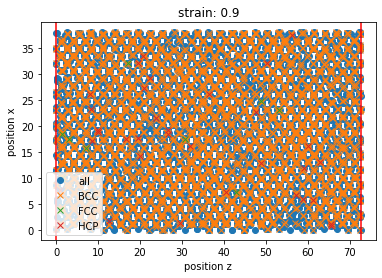

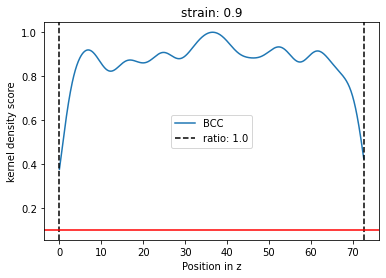

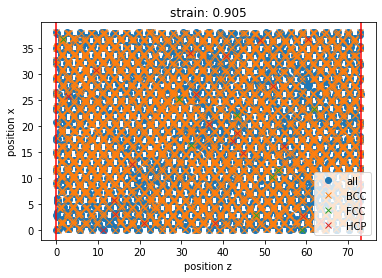

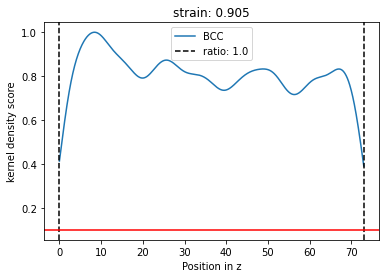

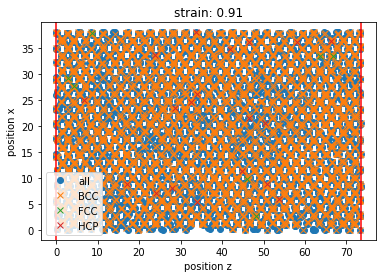

...

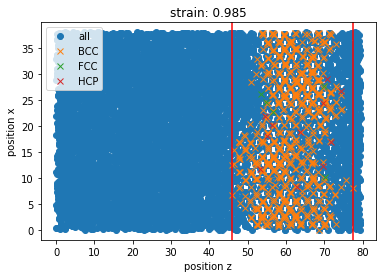

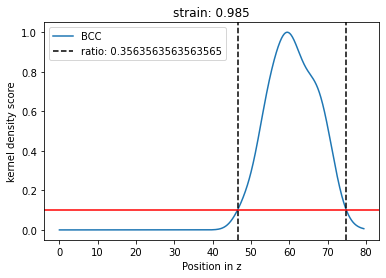

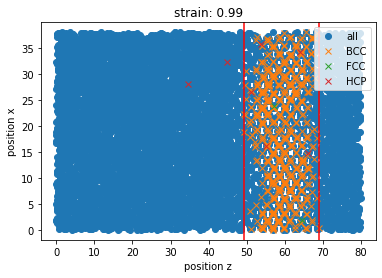

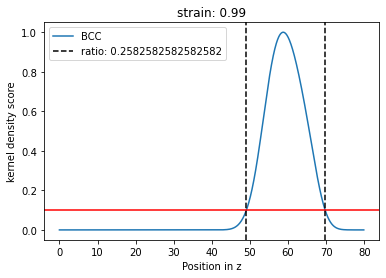

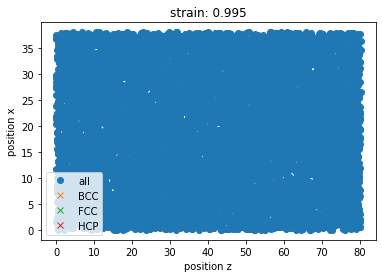

No handles with labels found to put in legend.


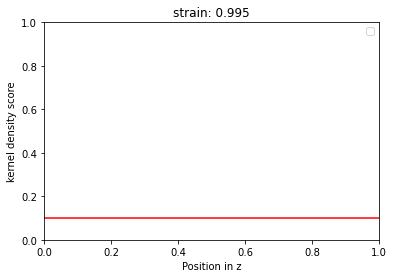

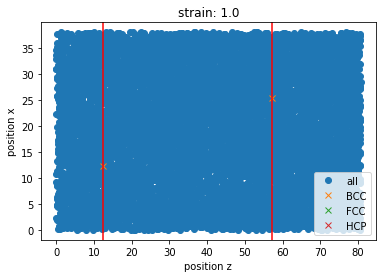

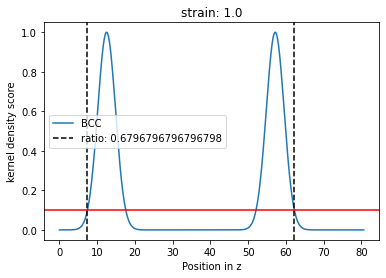

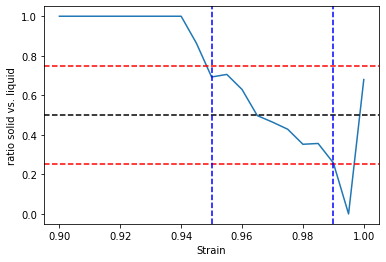

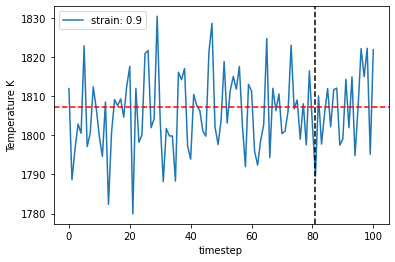

...

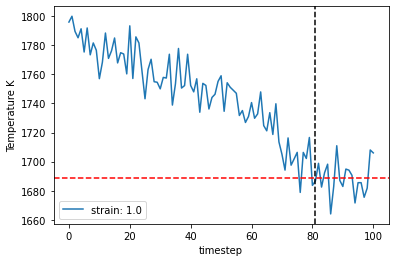

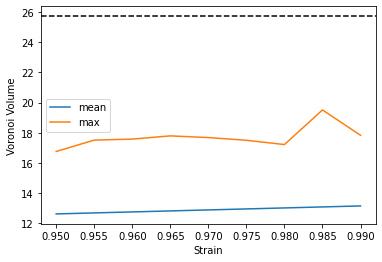

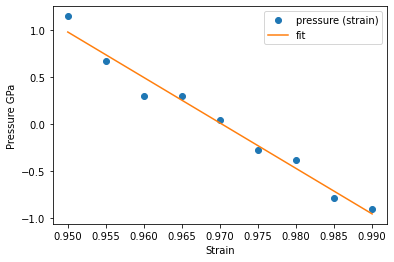

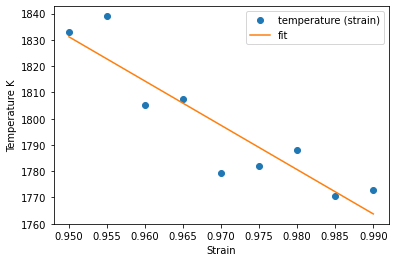

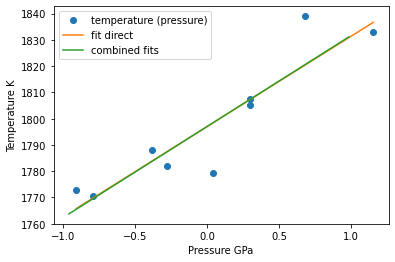

1796.9930971721303 1796.9891469682918
1796.9930971721303 1804.7918685947548 1787.6949278081854 1821.8888093813239
{'timestep': 2, 'fit_range': 0.01, 'nve_run_time_steps': 20000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1796.9930971721303, 'center': 0.97}


The job ham_npt_solid_1796_99 was saved and received the ID: 102


The job ham_npt_liquid_high_2796_99 was saved and received the ID: 103


The job ham_npt_liquid_low_1796_99 was saved and received the ID: 104


2020-05-04 10:48:23,124 - pyiron_log - WARNING - Job 'ham_nve_0_96_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_96_1796_99_1 was saved and received the ID: 105


2020-05-04 10:49:28,440 - pyiron_log - WARNING - Job 'ham_nve_0_961_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_961_1796_99_1 was saved and received the ID: 106


2020-05-04 10:50:32,964 - pyiron_log - WARNING - Job 'ham_nve_0_962_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_962_1796_99_1 was saved and received the ID: 107


2020-05-04 10:51:37,130 - pyiron_log - WARNING - Job 'ham_nve_0_963_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_963_1796_99_1 was saved and received the ID: 108


2020-05-04 10:52:41,152 - pyiron_log - WARNING - Job 'ham_nve_0_964_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_964_1796_99_1 was saved and received the ID: 109


2020-05-04 10:53:45,853 - pyiron_log - WARNING - Job 'ham_nve_0_965_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_965_1796_99_1 was saved and received the ID: 110


2020-05-04 10:54:49,917 - pyiron_log - WARNING - Job 'ham_nve_0_966_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_966_1796_99_1 was saved and received the ID: 111


2020-05-04 10:55:52,834 - pyiron_log - WARNING - Job 'ham_nve_0_967_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_967_1796_99_1 was saved and received the ID: 112


2020-05-04 10:56:56,759 - pyiron_log - WARNING - Job 'ham_nve_0_968_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_968_1796_99_1 was saved and received the ID: 113


2020-05-04 10:58:00,084 - pyiron_log - WARNING - Job 'ham_nve_0_969_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_969_1796_99_1 was saved and received the ID: 114


2020-05-04 10:59:03,884 - pyiron_log - WARNING - Job 'ham_nve_0_97_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_97_1796_99_1 was saved and received the ID: 115


2020-05-04 11:00:07,555 - pyiron_log - WARNING - Job 'ham_nve_0_971_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_971_1796_99_1 was saved and received the ID: 116


2020-05-04 11:01:10,368 - pyiron_log - WARNING - Job 'ham_nve_0_972_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_972_1796_99_1 was saved and received the ID: 117


2020-05-04 11:02:13,997 - pyiron_log - WARNING - Job 'ham_nve_0_973_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_973_1796_99_1 was saved and received the ID: 118


2020-05-04 11:03:17,556 - pyiron_log - WARNING - Job 'ham_nve_0_974_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_974_1796_99_1 was saved and received the ID: 119


2020-05-04 11:04:21,405 - pyiron_log - WARNING - Job 'ham_nve_0_975_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_975_1796_99_1 was saved and received the ID: 120


2020-05-04 11:05:24,456 - pyiron_log - WARNING - Job 'ham_nve_0_976_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_976_1796_99_1 was saved and received the ID: 121


2020-05-04 11:06:28,223 - pyiron_log - WARNING - Job 'ham_nve_0_977_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_977_1796_99_1 was saved and received the ID: 122


2020-05-04 11:07:31,914 - pyiron_log - WARNING - Job 'ham_nve_0_978_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_978_1796_99_1 was saved and received the ID: 123


2020-05-04 11:08:35,211 - pyiron_log - WARNING - Job 'ham_nve_0_979_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_979_1796_99_1 was saved and received the ID: 124


2020-05-04 11:09:39,186 - pyiron_log - WARNING - Job 'ham_nve_0_98_1796_99_1' does not exist and cannot be loaded


The job ham_nvt_0_98_1796_99_1 was saved and received the ID: 125


The job ham_nve_0_96_1796_99_1 was saved and received the ID: 126


The job ham_nve_0_961_1796_99_1 was saved and received the ID: 127


The job ham_nve_0_962_1796_99_1 was saved and received the ID: 128


The job ham_nve_0_963_1796_99_1 was saved and received the ID: 129


The job ham_nve_0_964_1796_99_1 was saved and received the ID: 130


The job ham_nve_0_965_1796_99_1 was saved and received the ID: 131


The job ham_nve_0_966_1796_99_1 was saved and received the ID: 132


The job ham_nve_0_967_1796_99_1 was saved and received the ID: 133


The job ham_nve_0_968_1796_99_1 was saved and received the ID: 134


The job ham_nve_0_969_1796_99_1 was saved and received the ID: 135


The job ham_nve_0_97_1796_99_1 was saved and received the ID: 136


The job ham_nve_0_971_1796_99_1 was saved and received the ID: 137


The job ham_nve_0_972_1796_99_1 was saved and received the ID: 138


The job ham_nve_0_973_1796_99_1 was saved and received the ID: 139


The job ham_nve_0_974_1796_99_1 was saved and received the ID: 140


The job ham_nve_0_975_1796_99_1 was saved and received the ID: 141


The job ham_nve_0_976_1796_99_1 was saved and received the ID: 142


The job ham_nve_0_977_1796_99_1 was saved and received the ID: 143


The job ham_nve_0_978_1796_99_1 was saved and received the ID: 144


The job ham_nve_0_979_1796_99_1 was saved and received the ID: 145


The job ham_nve_0_98_1796_99_1 was saved and received the ID: 146


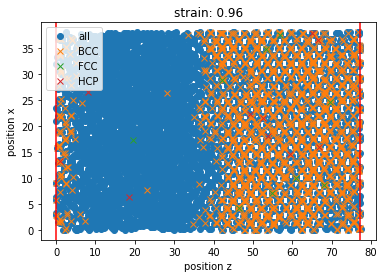

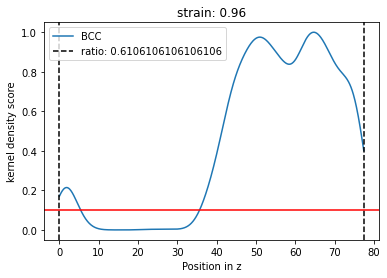

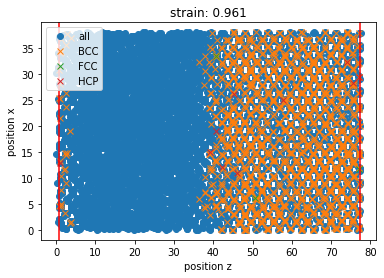

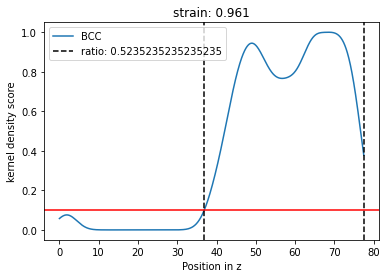

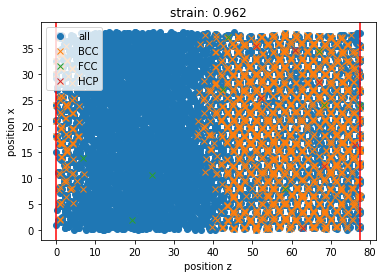

...

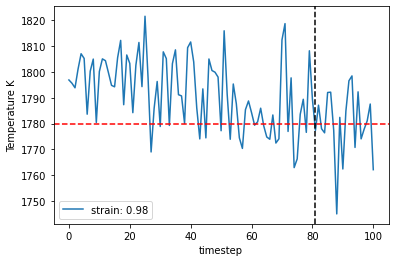

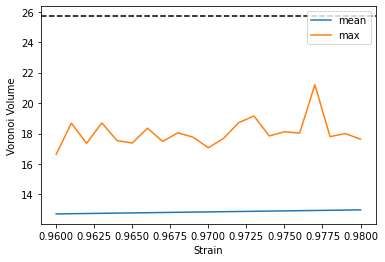

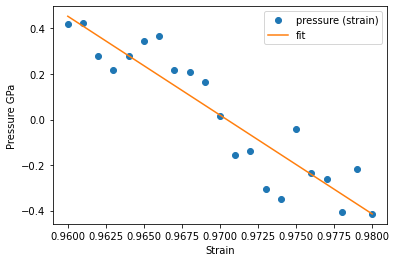

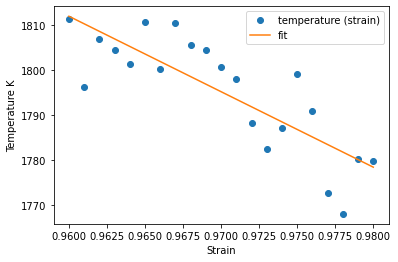

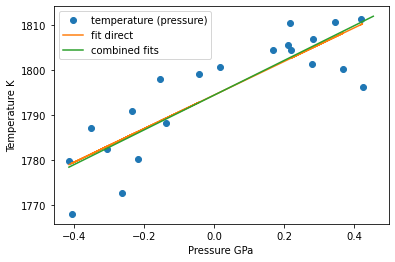

1794.4524012412219 1794.4274610311081
1794.4524012412219 1789.7083120901148 1778.855196817448 1800.5614273627814
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1794.4524012412219, 'center': 0.97}


The job ham_npt_solid_1794_45 was saved and received the ID: 147


The job ham_npt_liquid_high_2794_45 was saved and received the ID: 148


The job ham_npt_liquid_low_1794_45 was saved and received the ID: 149


2020-05-04 12:09:39,169 - pyiron_log - WARNING - Job 'ham_nve_0_96_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1794_45_2 was saved and received the ID: 150


2020-05-04 12:10:42,468 - pyiron_log - WARNING - Job 'ham_nve_0_961_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1794_45_2 was saved and received the ID: 151


2020-05-04 12:11:45,744 - pyiron_log - WARNING - Job 'ham_nve_0_962_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1794_45_2 was saved and received the ID: 152


2020-05-04 12:12:50,451 - pyiron_log - WARNING - Job 'ham_nve_0_963_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1794_45_2 was saved and received the ID: 153


2020-05-04 12:13:53,594 - pyiron_log - WARNING - Job 'ham_nve_0_964_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1794_45_2 was saved and received the ID: 154


2020-05-04 12:14:57,144 - pyiron_log - WARNING - Job 'ham_nve_0_965_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1794_45_2 was saved and received the ID: 155


2020-05-04 12:15:59,321 - pyiron_log - WARNING - Job 'ham_nve_0_966_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1794_45_2 was saved and received the ID: 156


2020-05-04 12:17:02,388 - pyiron_log - WARNING - Job 'ham_nve_0_967_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1794_45_2 was saved and received the ID: 157


2020-05-04 12:18:05,239 - pyiron_log - WARNING - Job 'ham_nve_0_968_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1794_45_2 was saved and received the ID: 158


2020-05-04 12:19:07,586 - pyiron_log - WARNING - Job 'ham_nve_0_969_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1794_45_2 was saved and received the ID: 159


2020-05-04 12:20:09,643 - pyiron_log - WARNING - Job 'ham_nve_0_97_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1794_45_2 was saved and received the ID: 160


2020-05-04 12:21:12,252 - pyiron_log - WARNING - Job 'ham_nve_0_971_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1794_45_2 was saved and received the ID: 161


2020-05-04 12:22:15,777 - pyiron_log - WARNING - Job 'ham_nve_0_972_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1794_45_2 was saved and received the ID: 162


2020-05-04 12:23:18,354 - pyiron_log - WARNING - Job 'ham_nve_0_973_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1794_45_2 was saved and received the ID: 163


2020-05-04 12:24:22,370 - pyiron_log - WARNING - Job 'ham_nve_0_974_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1794_45_2 was saved and received the ID: 164


2020-05-04 12:25:24,547 - pyiron_log - WARNING - Job 'ham_nve_0_975_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1794_45_2 was saved and received the ID: 165


2020-05-04 12:26:26,488 - pyiron_log - WARNING - Job 'ham_nve_0_976_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1794_45_2 was saved and received the ID: 166


2020-05-04 12:27:29,755 - pyiron_log - WARNING - Job 'ham_nve_0_977_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1794_45_2 was saved and received the ID: 167


2020-05-04 12:28:31,946 - pyiron_log - WARNING - Job 'ham_nve_0_978_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1794_45_2 was saved and received the ID: 168


2020-05-04 12:29:33,940 - pyiron_log - WARNING - Job 'ham_nve_0_979_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1794_45_2 was saved and received the ID: 169


2020-05-04 12:30:36,899 - pyiron_log - WARNING - Job 'ham_nve_0_98_1794_45_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1794_45_2 was saved and received the ID: 170


The job ham_nve_0_96_1794_45_2 was saved and received the ID: 171


The job ham_nve_0_961_1794_45_2 was saved and received the ID: 172


The job ham_nve_0_962_1794_45_2 was saved and received the ID: 173


The job ham_nve_0_963_1794_45_2 was saved and received the ID: 174


The job ham_nve_0_964_1794_45_2 was saved and received the ID: 175


The job ham_nve_0_965_1794_45_2 was saved and received the ID: 176


The job ham_nve_0_966_1794_45_2 was saved and received the ID: 177


The job ham_nve_0_967_1794_45_2 was saved and received the ID: 178


The job ham_nve_0_968_1794_45_2 was saved and received the ID: 179


The job ham_nve_0_969_1794_45_2 was saved and received the ID: 180


The job ham_nve_0_97_1794_45_2 was saved and received the ID: 181


The job ham_nve_0_971_1794_45_2 was saved and received the ID: 182


The job ham_nve_0_972_1794_45_2 was saved and received the ID: 183


The job ham_nve_0_973_1794_45_2 was saved and received the ID: 184


The job ham_nve_0_974_1794_45_2 was saved and received the ID: 185


The job ham_nve_0_975_1794_45_2 was saved and received the ID: 186


The job ham_nve_0_976_1794_45_2 was saved and received the ID: 187


The job ham_nve_0_977_1794_45_2 was saved and received the ID: 188


The job ham_nve_0_978_1794_45_2 was saved and received the ID: 189


The job ham_nve_0_979_1794_45_2 was saved and received the ID: 190


The job ham_nve_0_98_1794_45_2 was saved and received the ID: 191


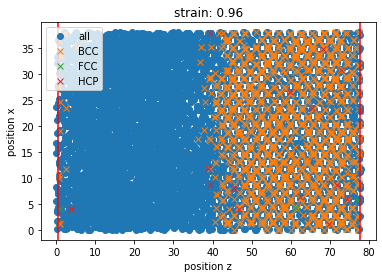

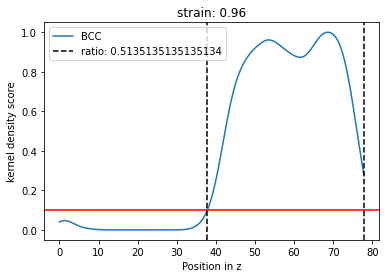

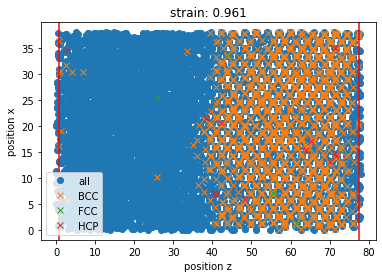

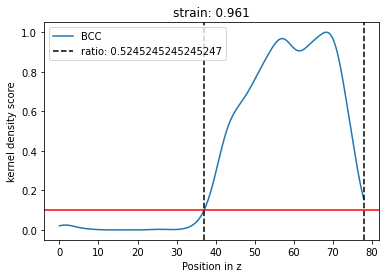

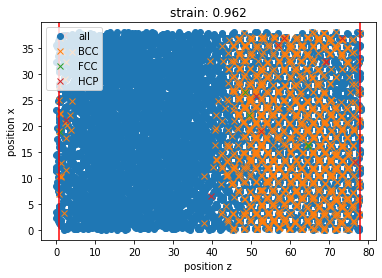

...

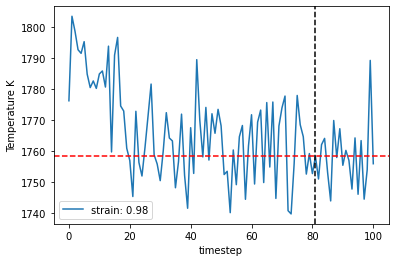

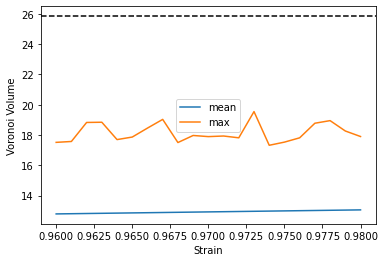

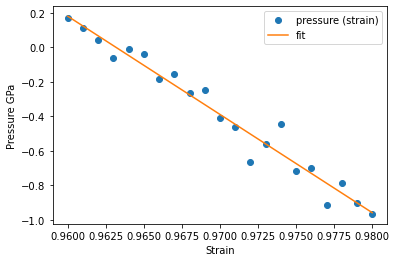

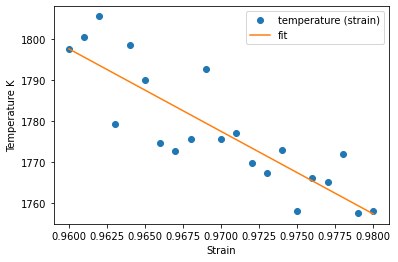

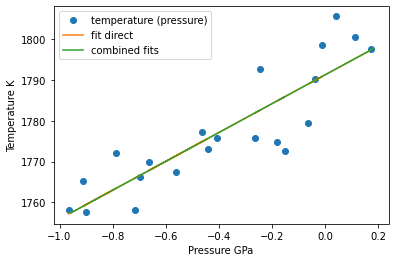

1791.2727524102718 1791.2746752695034
1791.2727524102718 1781.6402043606038 1769.6475906968997 1793.6328180243079
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1791.2727524102718, 'center': 0.96}


The job ham_npt_solid_1791_27 was saved and received the ID: 192


The job ham_npt_liquid_high_2791_27 was saved and received the ID: 193


The job ham_npt_liquid_low_1791_27 was saved and received the ID: 194


2020-05-04 14:30:38,848 - pyiron_log - WARNING - Job 'ham_nve_0_95_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_95_1791_27_2 was saved and received the ID: 195


2020-05-04 14:31:42,754 - pyiron_log - WARNING - Job 'ham_nve_0_951_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_951_1791_27_2 was saved and received the ID: 196


2020-05-04 14:32:46,678 - pyiron_log - WARNING - Job 'ham_nve_0_952_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_952_1791_27_2 was saved and received the ID: 197


2020-05-04 14:33:50,183 - pyiron_log - WARNING - Job 'ham_nve_0_953_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_953_1791_27_2 was saved and received the ID: 198


2020-05-04 14:34:54,511 - pyiron_log - WARNING - Job 'ham_nve_0_954_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_954_1791_27_2 was saved and received the ID: 199


2020-05-04 14:35:59,618 - pyiron_log - WARNING - Job 'ham_nve_0_955_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_955_1791_27_2 was saved and received the ID: 200


2020-05-04 14:37:04,733 - pyiron_log - WARNING - Job 'ham_nve_0_956_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_956_1791_27_2 was saved and received the ID: 201


2020-05-04 14:38:09,171 - pyiron_log - WARNING - Job 'ham_nve_0_957_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_957_1791_27_2 was saved and received the ID: 202


2020-05-04 14:39:13,071 - pyiron_log - WARNING - Job 'ham_nve_0_958_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_958_1791_27_2 was saved and received the ID: 203


2020-05-04 14:40:16,704 - pyiron_log - WARNING - Job 'ham_nve_0_959_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_959_1791_27_2 was saved and received the ID: 204


2020-05-04 14:41:19,946 - pyiron_log - WARNING - Job 'ham_nve_0_96_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1791_27_2 was saved and received the ID: 205


2020-05-04 14:42:23,696 - pyiron_log - WARNING - Job 'ham_nve_0_961_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1791_27_2 was saved and received the ID: 206


2020-05-04 14:43:27,505 - pyiron_log - WARNING - Job 'ham_nve_0_962_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1791_27_2 was saved and received the ID: 207


2020-05-04 14:44:31,480 - pyiron_log - WARNING - Job 'ham_nve_0_963_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1791_27_2 was saved and received the ID: 208


2020-05-04 14:45:34,575 - pyiron_log - WARNING - Job 'ham_nve_0_964_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1791_27_2 was saved and received the ID: 209


2020-05-04 14:46:40,038 - pyiron_log - WARNING - Job 'ham_nve_0_965_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1791_27_2 was saved and received the ID: 210


2020-05-04 14:47:42,989 - pyiron_log - WARNING - Job 'ham_nve_0_966_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1791_27_2 was saved and received the ID: 211


2020-05-04 14:48:45,914 - pyiron_log - WARNING - Job 'ham_nve_0_967_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1791_27_2 was saved and received the ID: 212


2020-05-04 14:49:49,440 - pyiron_log - WARNING - Job 'ham_nve_0_968_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1791_27_2 was saved and received the ID: 213


2020-05-04 14:50:52,216 - pyiron_log - WARNING - Job 'ham_nve_0_969_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1791_27_2 was saved and received the ID: 214


2020-05-04 14:51:55,525 - pyiron_log - WARNING - Job 'ham_nve_0_97_1791_27_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1791_27_2 was saved and received the ID: 215


The job ham_nve_0_95_1791_27_2 was saved and received the ID: 216


The job ham_nve_0_951_1791_27_2 was saved and received the ID: 217


The job ham_nve_0_952_1791_27_2 was saved and received the ID: 218


The job ham_nve_0_953_1791_27_2 was saved and received the ID: 219


The job ham_nve_0_954_1791_27_2 was saved and received the ID: 220


The job ham_nve_0_955_1791_27_2 was saved and received the ID: 221


The job ham_nve_0_956_1791_27_2 was saved and received the ID: 222


The job ham_nve_0_957_1791_27_2 was saved and received the ID: 223


The job ham_nve_0_958_1791_27_2 was saved and received the ID: 224


The job ham_nve_0_959_1791_27_2 was saved and received the ID: 225


The job ham_nve_0_96_1791_27_2 was saved and received the ID: 226


The job ham_nve_0_961_1791_27_2 was saved and received the ID: 227


The job ham_nve_0_962_1791_27_2 was saved and received the ID: 228


The job ham_nve_0_963_1791_27_2 was saved and received the ID: 229


The job ham_nve_0_964_1791_27_2 was saved and received the ID: 230


The job ham_nve_0_965_1791_27_2 was saved and received the ID: 231


The job ham_nve_0_966_1791_27_2 was saved and received the ID: 232


The job ham_nve_0_967_1791_27_2 was saved and received the ID: 233


The job ham_nve_0_968_1791_27_2 was saved and received the ID: 234


The job ham_nve_0_969_1791_27_2 was saved and received the ID: 235


The job ham_nve_0_97_1791_27_2 was saved and received the ID: 236


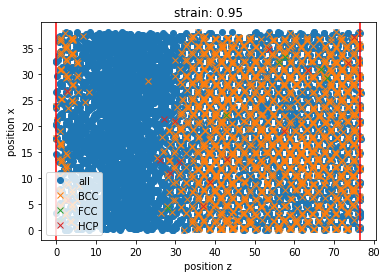

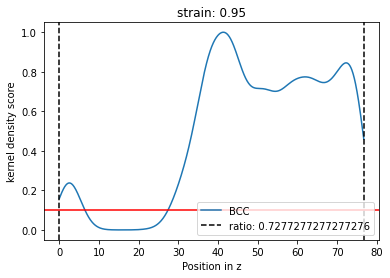

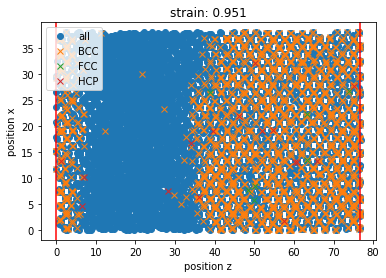

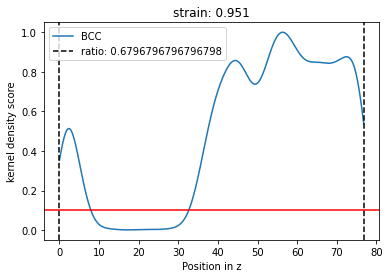

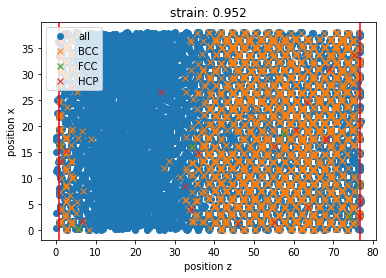

...

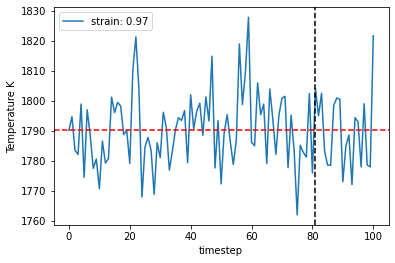

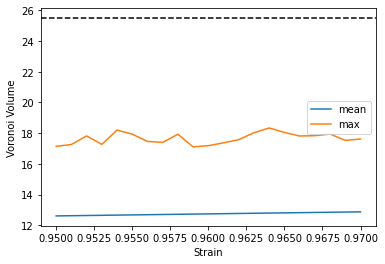

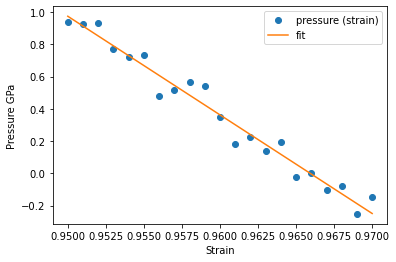

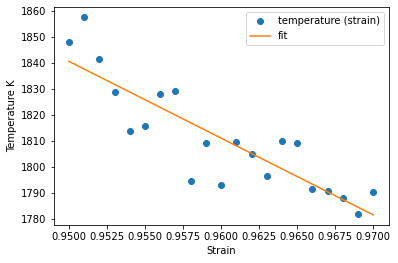

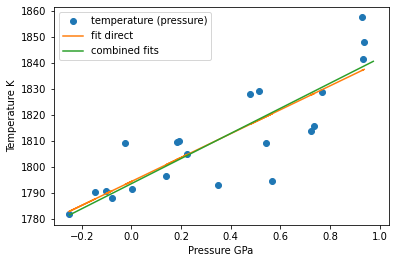

1794.3596870654974 1793.521762168926
1794.3596870654974 1819.6465211042912 1800.648632915232 1838.6444092933505
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1794.3596870654974, 'center': 0.97}


The job ham_npt_solid_1794_36 was saved and received the ID: 237


The job ham_npt_liquid_high_2794_3599999999997 was saved and received the ID: 238


The job ham_npt_liquid_low_1794_36 was saved and received the ID: 239


2020-05-04 16:54:30,127 - pyiron_log - WARNING - Job 'ham_nve_0_96_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1794_36_2 was saved and received the ID: 240


2020-05-04 16:55:33,315 - pyiron_log - WARNING - Job 'ham_nve_0_961_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1794_36_2 was saved and received the ID: 241


2020-05-04 16:56:38,688 - pyiron_log - WARNING - Job 'ham_nve_0_962_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1794_36_2 was saved and received the ID: 242


2020-05-04 16:57:42,863 - pyiron_log - WARNING - Job 'ham_nve_0_963_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1794_36_2 was saved and received the ID: 243


2020-05-04 16:58:46,454 - pyiron_log - WARNING - Job 'ham_nve_0_964_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1794_36_2 was saved and received the ID: 244


2020-05-04 16:59:49,873 - pyiron_log - WARNING - Job 'ham_nve_0_965_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1794_36_2 was saved and received the ID: 245


2020-05-04 17:00:53,741 - pyiron_log - WARNING - Job 'ham_nve_0_966_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1794_36_2 was saved and received the ID: 246


2020-05-04 17:01:57,467 - pyiron_log - WARNING - Job 'ham_nve_0_967_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1794_36_2 was saved and received the ID: 247


2020-05-04 17:03:00,444 - pyiron_log - WARNING - Job 'ham_nve_0_968_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1794_36_2 was saved and received the ID: 248


2020-05-04 17:04:03,370 - pyiron_log - WARNING - Job 'ham_nve_0_969_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1794_36_2 was saved and received the ID: 249


2020-05-04 17:05:06,821 - pyiron_log - WARNING - Job 'ham_nve_0_97_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1794_36_2 was saved and received the ID: 250


2020-05-04 17:06:08,716 - pyiron_log - WARNING - Job 'ham_nve_0_971_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1794_36_2 was saved and received the ID: 251


2020-05-04 17:07:11,742 - pyiron_log - WARNING - Job 'ham_nve_0_972_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1794_36_2 was saved and received the ID: 252


2020-05-04 17:08:15,101 - pyiron_log - WARNING - Job 'ham_nve_0_973_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1794_36_2 was saved and received the ID: 253


2020-05-04 17:09:16,612 - pyiron_log - WARNING - Job 'ham_nve_0_974_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1794_36_2 was saved and received the ID: 254


2020-05-04 17:10:19,080 - pyiron_log - WARNING - Job 'ham_nve_0_975_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1794_36_2 was saved and received the ID: 255


2020-05-04 17:11:21,474 - pyiron_log - WARNING - Job 'ham_nve_0_976_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1794_36_2 was saved and received the ID: 256


2020-05-04 17:12:23,660 - pyiron_log - WARNING - Job 'ham_nve_0_977_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1794_36_2 was saved and received the ID: 257


2020-05-04 17:13:25,578 - pyiron_log - WARNING - Job 'ham_nve_0_978_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1794_36_2 was saved and received the ID: 258


2020-05-04 17:14:27,830 - pyiron_log - WARNING - Job 'ham_nve_0_979_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1794_36_2 was saved and received the ID: 259


2020-05-04 17:15:29,599 - pyiron_log - WARNING - Job 'ham_nve_0_98_1794_36_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1794_36_2 was saved and received the ID: 260


The job ham_nve_0_96_1794_36_2 was saved and received the ID: 261


The job ham_nve_0_961_1794_36_2 was saved and received the ID: 262


The job ham_nve_0_962_1794_36_2 was saved and received the ID: 263


The job ham_nve_0_963_1794_36_2 was saved and received the ID: 264


The job ham_nve_0_964_1794_36_2 was saved and received the ID: 265


The job ham_nve_0_965_1794_36_2 was saved and received the ID: 266


The job ham_nve_0_966_1794_36_2 was saved and received the ID: 267


The job ham_nve_0_967_1794_36_2 was saved and received the ID: 268


The job ham_nve_0_968_1794_36_2 was saved and received the ID: 269


The job ham_nve_0_969_1794_36_2 was saved and received the ID: 270


The job ham_nve_0_97_1794_36_2 was saved and received the ID: 271


The job ham_nve_0_971_1794_36_2 was saved and received the ID: 272


The job ham_nve_0_972_1794_36_2 was saved and received the ID: 273


The job ham_nve_0_973_1794_36_2 was saved and received the ID: 274


The job ham_nve_0_974_1794_36_2 was saved and received the ID: 275


The job ham_nve_0_975_1794_36_2 was saved and received the ID: 276


The job ham_nve_0_976_1794_36_2 was saved and received the ID: 277


The job ham_nve_0_977_1794_36_2 was saved and received the ID: 278


The job ham_nve_0_978_1794_36_2 was saved and received the ID: 279


The job ham_nve_0_979_1794_36_2 was saved and received the ID: 280


The job ham_nve_0_98_1794_36_2 was saved and received the ID: 281


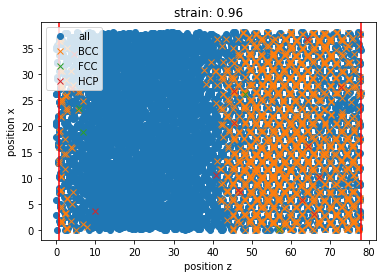

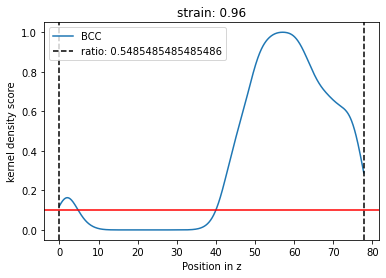

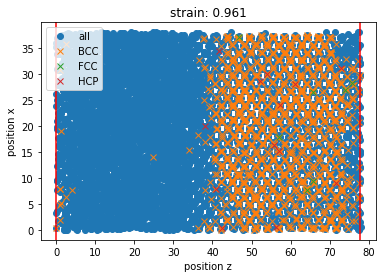

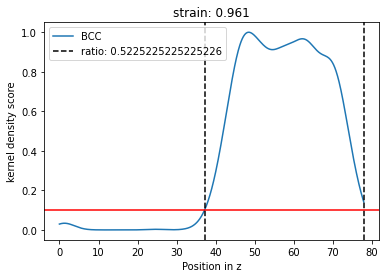

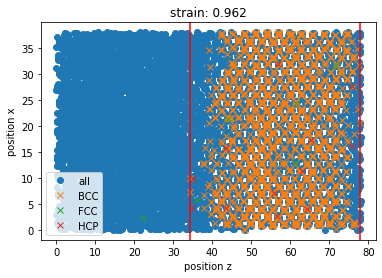

...

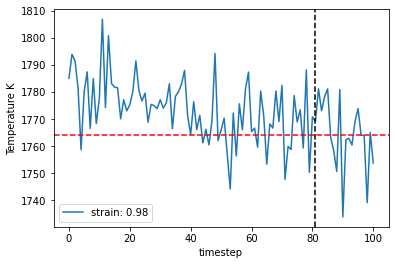

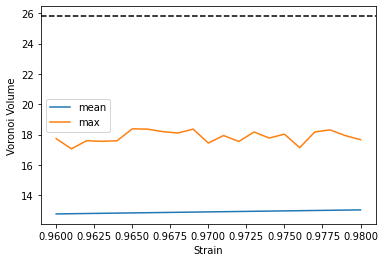

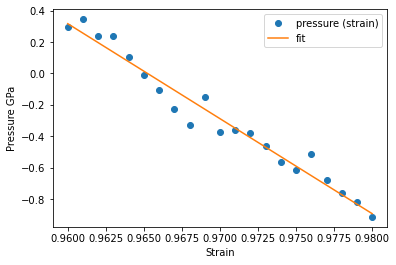

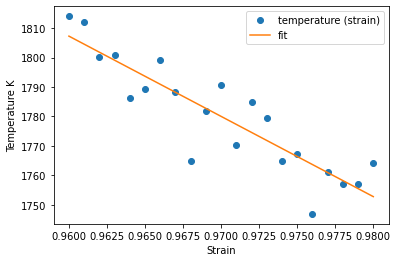

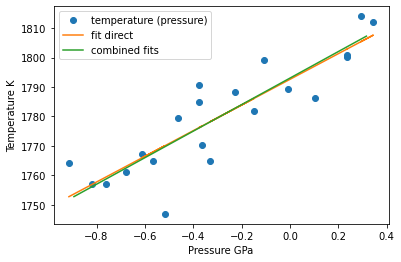

1792.6042188502827 1793.0272722347013
1792.6042188502827 1780.4631334552146 1763.6845337894924 1797.241733120937
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1792.6042188502827, 'center': 0.97}


The job ham_npt_solid_1792_6 was saved and received the ID: 282


The job ham_npt_liquid_high_2792_6 was saved and received the ID: 283


The job ham_npt_liquid_low_1792_6 was saved and received the ID: 284


2020-05-04 19:15:32,754 - pyiron_log - WARNING - Job 'ham_nve_0_96_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1792_6_2 was saved and received the ID: 285


2020-05-04 19:16:35,433 - pyiron_log - WARNING - Job 'ham_nve_0_961_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1792_6_2 was saved and received the ID: 286


2020-05-04 19:17:39,308 - pyiron_log - WARNING - Job 'ham_nve_0_962_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1792_6_2 was saved and received the ID: 287


2020-05-04 19:18:42,874 - pyiron_log - WARNING - Job 'ham_nve_0_963_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1792_6_2 was saved and received the ID: 288


2020-05-04 19:19:45,750 - pyiron_log - WARNING - Job 'ham_nve_0_964_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1792_6_2 was saved and received the ID: 289


2020-05-04 19:20:48,950 - pyiron_log - WARNING - Job 'ham_nve_0_965_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1792_6_2 was saved and received the ID: 290


2020-05-04 19:21:50,884 - pyiron_log - WARNING - Job 'ham_nve_0_966_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1792_6_2 was saved and received the ID: 291


2020-05-04 19:22:53,960 - pyiron_log - WARNING - Job 'ham_nve_0_967_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1792_6_2 was saved and received the ID: 292


2020-05-04 19:23:57,635 - pyiron_log - WARNING - Job 'ham_nve_0_968_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1792_6_2 was saved and received the ID: 293


2020-05-04 19:25:01,001 - pyiron_log - WARNING - Job 'ham_nve_0_969_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1792_6_2 was saved and received the ID: 294


2020-05-04 19:26:03,969 - pyiron_log - WARNING - Job 'ham_nve_0_97_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1792_6_2 was saved and received the ID: 295


2020-05-04 19:27:07,227 - pyiron_log - WARNING - Job 'ham_nve_0_971_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1792_6_2 was saved and received the ID: 296


2020-05-04 19:28:09,587 - pyiron_log - WARNING - Job 'ham_nve_0_972_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1792_6_2 was saved and received the ID: 297


2020-05-04 19:29:12,288 - pyiron_log - WARNING - Job 'ham_nve_0_973_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1792_6_2 was saved and received the ID: 298


2020-05-04 19:30:15,763 - pyiron_log - WARNING - Job 'ham_nve_0_974_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1792_6_2 was saved and received the ID: 299


2020-05-04 19:31:18,738 - pyiron_log - WARNING - Job 'ham_nve_0_975_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1792_6_2 was saved and received the ID: 300


2020-05-04 19:32:21,939 - pyiron_log - WARNING - Job 'ham_nve_0_976_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1792_6_2 was saved and received the ID: 301


2020-05-04 19:33:24,223 - pyiron_log - WARNING - Job 'ham_nve_0_977_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1792_6_2 was saved and received the ID: 302


2020-05-04 19:34:26,974 - pyiron_log - WARNING - Job 'ham_nve_0_978_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1792_6_2 was saved and received the ID: 303


2020-05-04 19:35:28,576 - pyiron_log - WARNING - Job 'ham_nve_0_979_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1792_6_2 was saved and received the ID: 304


2020-05-04 19:36:30,810 - pyiron_log - WARNING - Job 'ham_nve_0_98_1792_6_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1792_6_2 was saved and received the ID: 305


The job ham_nve_0_96_1792_6_2 was saved and received the ID: 306


The job ham_nve_0_961_1792_6_2 was saved and received the ID: 307


The job ham_nve_0_962_1792_6_2 was saved and received the ID: 308


The job ham_nve_0_963_1792_6_2 was saved and received the ID: 309


The job ham_nve_0_964_1792_6_2 was saved and received the ID: 310


The job ham_nve_0_965_1792_6_2 was saved and received the ID: 311


The job ham_nve_0_966_1792_6_2 was saved and received the ID: 312


The job ham_nve_0_967_1792_6_2 was saved and received the ID: 313


The job ham_nve_0_968_1792_6_2 was saved and received the ID: 314


The job ham_nve_0_969_1792_6_2 was saved and received the ID: 315


The job ham_nve_0_97_1792_6_2 was saved and received the ID: 316


The job ham_nve_0_971_1792_6_2 was saved and received the ID: 317


The job ham_nve_0_972_1792_6_2 was saved and received the ID: 318


The job ham_nve_0_973_1792_6_2 was saved and received the ID: 319


The job ham_nve_0_974_1792_6_2 was saved and received the ID: 320


The job ham_nve_0_975_1792_6_2 was saved and received the ID: 321


The job ham_nve_0_976_1792_6_2 was saved and received the ID: 322


The job ham_nve_0_977_1792_6_2 was saved and received the ID: 323


The job ham_nve_0_978_1792_6_2 was saved and received the ID: 324


The job ham_nve_0_979_1792_6_2 was saved and received the ID: 325


The job ham_nve_0_98_1792_6_2 was saved and received the ID: 326


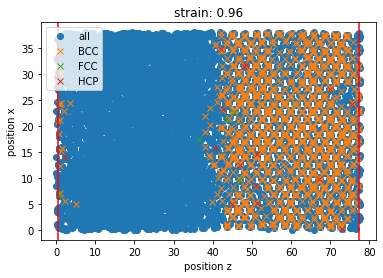

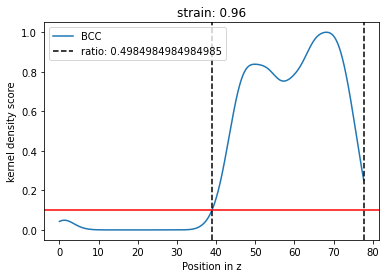

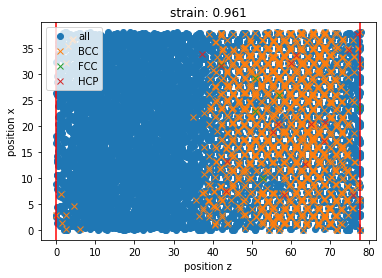

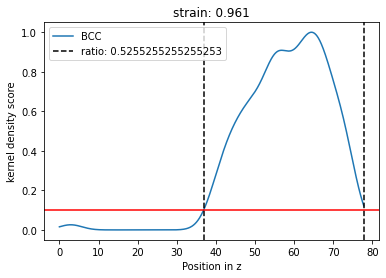

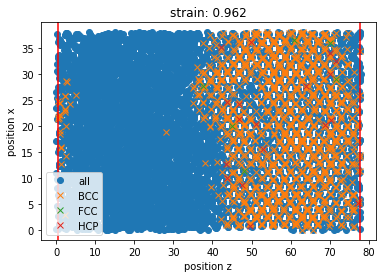

...

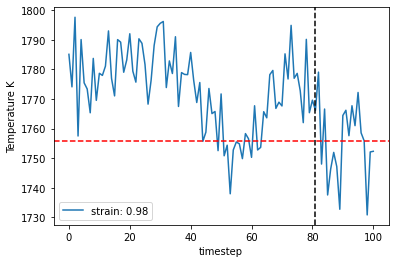

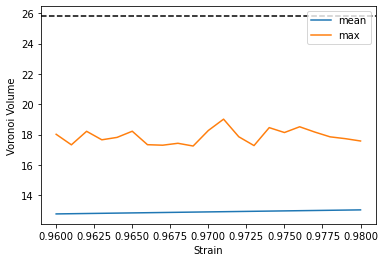

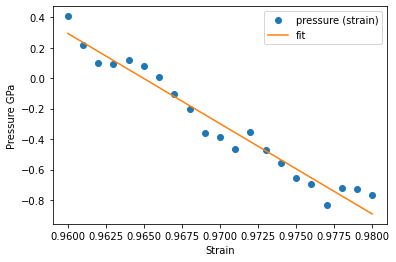

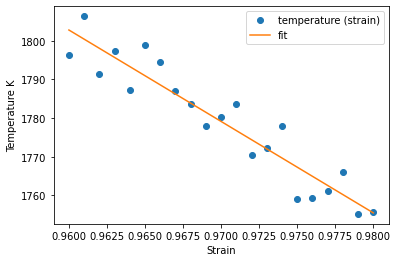

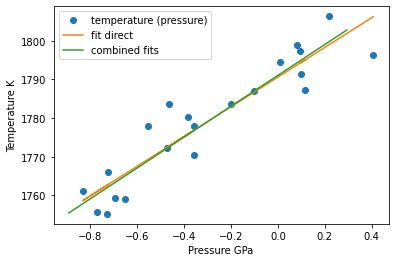

1790.5946040201784 1791.0423419033928
1790.5946040201784 1780.7747316980035 1767.996050268909 1793.5534131270979
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1790.5946040201784, 'center': 0.96}


The job ham_npt_solid_1790_59 was saved and received the ID: 327


The job ham_npt_liquid_high_2790_59 was saved and received the ID: 328


The job ham_npt_liquid_low_1790_59 was saved and received the ID: 329


2020-05-04 21:36:51,603 - pyiron_log - WARNING - Job 'ham_nve_0_95_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_95_1790_59_2 was saved and received the ID: 330


2020-05-04 21:37:55,715 - pyiron_log - WARNING - Job 'ham_nve_0_951_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_951_1790_59_2 was saved and received the ID: 331


2020-05-04 21:39:00,040 - pyiron_log - WARNING - Job 'ham_nve_0_952_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_952_1790_59_2 was saved and received the ID: 332


2020-05-04 21:40:04,039 - pyiron_log - WARNING - Job 'ham_nve_0_953_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_953_1790_59_2 was saved and received the ID: 333


2020-05-04 21:41:07,265 - pyiron_log - WARNING - Job 'ham_nve_0_954_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_954_1790_59_2 was saved and received the ID: 334


2020-05-04 21:42:11,831 - pyiron_log - WARNING - Job 'ham_nve_0_955_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_955_1790_59_2 was saved and received the ID: 335


2020-05-04 21:43:15,706 - pyiron_log - WARNING - Job 'ham_nve_0_956_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_956_1790_59_2 was saved and received the ID: 336


2020-05-04 21:44:20,155 - pyiron_log - WARNING - Job 'ham_nve_0_957_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_957_1790_59_2 was saved and received the ID: 337


2020-05-04 21:45:24,646 - pyiron_log - WARNING - Job 'ham_nve_0_958_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_958_1790_59_2 was saved and received the ID: 338


2020-05-04 21:46:27,730 - pyiron_log - WARNING - Job 'ham_nve_0_959_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_959_1790_59_2 was saved and received the ID: 339


2020-05-04 21:47:31,555 - pyiron_log - WARNING - Job 'ham_nve_0_96_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1790_59_2 was saved and received the ID: 340


2020-05-04 21:48:35,963 - pyiron_log - WARNING - Job 'ham_nve_0_961_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1790_59_2 was saved and received the ID: 341


2020-05-04 21:49:39,921 - pyiron_log - WARNING - Job 'ham_nve_0_962_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1790_59_2 was saved and received the ID: 342


2020-05-04 21:50:43,338 - pyiron_log - WARNING - Job 'ham_nve_0_963_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1790_59_2 was saved and received the ID: 343


2020-05-04 21:51:47,254 - pyiron_log - WARNING - Job 'ham_nve_0_964_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1790_59_2 was saved and received the ID: 344


2020-05-04 21:52:50,438 - pyiron_log - WARNING - Job 'ham_nve_0_965_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1790_59_2 was saved and received the ID: 345


2020-05-04 21:53:54,005 - pyiron_log - WARNING - Job 'ham_nve_0_966_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1790_59_2 was saved and received the ID: 346


2020-05-04 21:54:57,872 - pyiron_log - WARNING - Job 'ham_nve_0_967_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1790_59_2 was saved and received the ID: 347


2020-05-04 21:56:01,830 - pyiron_log - WARNING - Job 'ham_nve_0_968_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1790_59_2 was saved and received the ID: 348


2020-05-04 21:57:04,663 - pyiron_log - WARNING - Job 'ham_nve_0_969_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1790_59_2 was saved and received the ID: 349


2020-05-04 21:58:08,846 - pyiron_log - WARNING - Job 'ham_nve_0_97_1790_59_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1790_59_2 was saved and received the ID: 350


The job ham_nve_0_95_1790_59_2 was saved and received the ID: 351


The job ham_nve_0_951_1790_59_2 was saved and received the ID: 352


The job ham_nve_0_952_1790_59_2 was saved and received the ID: 353


The job ham_nve_0_953_1790_59_2 was saved and received the ID: 354


The job ham_nve_0_954_1790_59_2 was saved and received the ID: 355


The job ham_nve_0_955_1790_59_2 was saved and received the ID: 356


The job ham_nve_0_956_1790_59_2 was saved and received the ID: 357


The job ham_nve_0_957_1790_59_2 was saved and received the ID: 358


The job ham_nve_0_958_1790_59_2 was saved and received the ID: 359


The job ham_nve_0_959_1790_59_2 was saved and received the ID: 360


The job ham_nve_0_96_1790_59_2 was saved and received the ID: 361


The job ham_nve_0_961_1790_59_2 was saved and received the ID: 362


The job ham_nve_0_962_1790_59_2 was saved and received the ID: 363


The job ham_nve_0_963_1790_59_2 was saved and received the ID: 364


The job ham_nve_0_964_1790_59_2 was saved and received the ID: 365


The job ham_nve_0_965_1790_59_2 was saved and received the ID: 366


The job ham_nve_0_966_1790_59_2 was saved and received the ID: 367


The job ham_nve_0_967_1790_59_2 was saved and received the ID: 368


The job ham_nve_0_968_1790_59_2 was saved and received the ID: 369


The job ham_nve_0_969_1790_59_2 was saved and received the ID: 370


The job ham_nve_0_97_1790_59_2 was saved and received the ID: 371


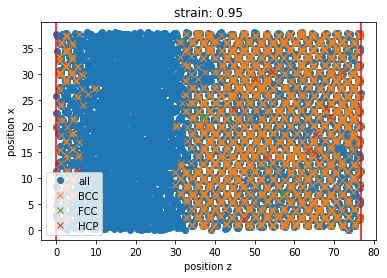

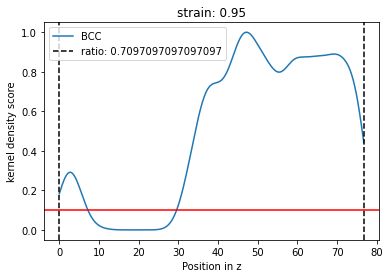

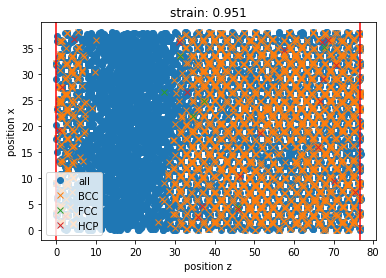

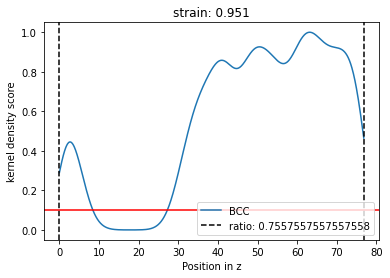

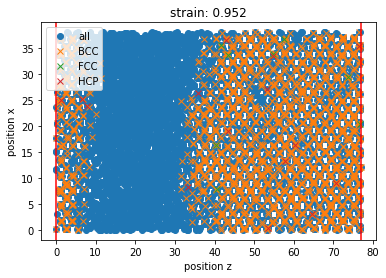

...

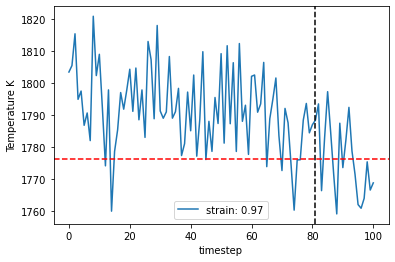

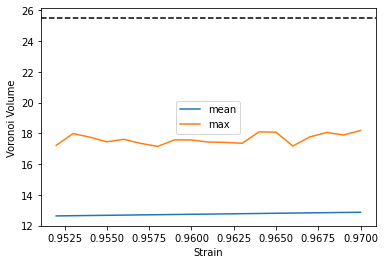

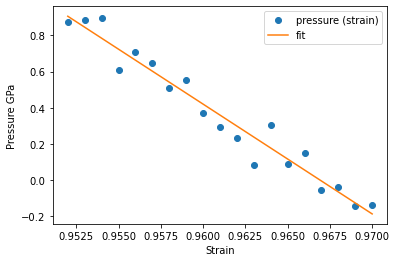

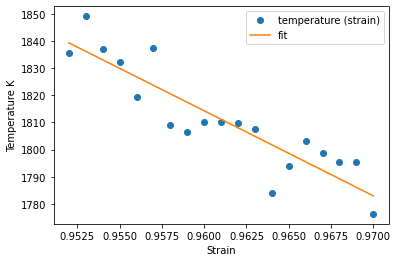

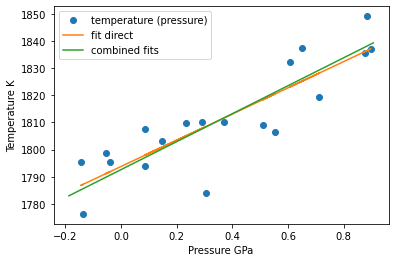

1793.7826586684043 1792.6286599110285
1793.7826586684043 1812.7095158687594 1794.5112993131743 1830.9077324243444
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1793.7826586684043, 'center': 0.97}


The job ham_npt_solid_1793_78 was saved and received the ID: 372


The job ham_npt_liquid_high_2793_7799999999997 was saved and received the ID: 373


The job ham_npt_liquid_low_1793_78 was saved and received the ID: 374


2020-05-05 00:00:08,906 - pyiron_log - WARNING - Job 'ham_nve_0_96_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1793_78_2 was saved and received the ID: 375


2020-05-05 00:01:12,968 - pyiron_log - WARNING - Job 'ham_nve_0_961_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1793_78_2 was saved and received the ID: 376


2020-05-05 00:02:16,701 - pyiron_log - WARNING - Job 'ham_nve_0_962_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1793_78_2 was saved and received the ID: 377


2020-05-05 00:03:21,508 - pyiron_log - WARNING - Job 'ham_nve_0_963_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1793_78_2 was saved and received the ID: 378


2020-05-05 00:04:24,934 - pyiron_log - WARNING - Job 'ham_nve_0_964_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1793_78_2 was saved and received the ID: 379


2020-05-05 00:05:28,183 - pyiron_log - WARNING - Job 'ham_nve_0_965_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1793_78_2 was saved and received the ID: 380


2020-05-05 00:06:31,085 - pyiron_log - WARNING - Job 'ham_nve_0_966_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1793_78_2 was saved and received the ID: 381


2020-05-05 00:07:35,009 - pyiron_log - WARNING - Job 'ham_nve_0_967_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1793_78_2 was saved and received the ID: 382


2020-05-05 00:08:38,701 - pyiron_log - WARNING - Job 'ham_nve_0_968_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1793_78_2 was saved and received the ID: 383


2020-05-05 00:09:41,602 - pyiron_log - WARNING - Job 'ham_nve_0_969_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1793_78_2 was saved and received the ID: 384


2020-05-05 00:10:44,311 - pyiron_log - WARNING - Job 'ham_nve_0_97_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1793_78_2 was saved and received the ID: 385


2020-05-05 00:11:47,944 - pyiron_log - WARNING - Job 'ham_nve_0_971_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1793_78_2 was saved and received the ID: 386


2020-05-05 00:12:50,212 - pyiron_log - WARNING - Job 'ham_nve_0_972_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1793_78_2 was saved and received the ID: 387


2020-05-05 00:13:53,338 - pyiron_log - WARNING - Job 'ham_nve_0_973_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1793_78_2 was saved and received the ID: 388


2020-05-05 00:14:55,555 - pyiron_log - WARNING - Job 'ham_nve_0_974_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1793_78_2 was saved and received the ID: 389


2020-05-05 00:15:59,589 - pyiron_log - WARNING - Job 'ham_nve_0_975_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1793_78_2 was saved and received the ID: 390


2020-05-05 00:17:02,473 - pyiron_log - WARNING - Job 'ham_nve_0_976_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1793_78_2 was saved and received the ID: 391


2020-05-05 00:18:05,116 - pyiron_log - WARNING - Job 'ham_nve_0_977_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1793_78_2 was saved and received the ID: 392


2020-05-05 00:19:09,041 - pyiron_log - WARNING - Job 'ham_nve_0_978_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1793_78_2 was saved and received the ID: 393


2020-05-05 00:20:11,625 - pyiron_log - WARNING - Job 'ham_nve_0_979_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1793_78_2 was saved and received the ID: 394


2020-05-05 00:21:13,843 - pyiron_log - WARNING - Job 'ham_nve_0_98_1793_78_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1793_78_2 was saved and received the ID: 395


The job ham_nve_0_96_1793_78_2 was saved and received the ID: 396


The job ham_nve_0_961_1793_78_2 was saved and received the ID: 397


The job ham_nve_0_962_1793_78_2 was saved and received the ID: 398


The job ham_nve_0_963_1793_78_2 was saved and received the ID: 399


The job ham_nve_0_964_1793_78_2 was saved and received the ID: 400


The job ham_nve_0_965_1793_78_2 was saved and received the ID: 401


The job ham_nve_0_966_1793_78_2 was saved and received the ID: 402


The job ham_nve_0_967_1793_78_2 was saved and received the ID: 403


The job ham_nve_0_968_1793_78_2 was saved and received the ID: 404


The job ham_nve_0_969_1793_78_2 was saved and received the ID: 405


The job ham_nve_0_97_1793_78_2 was saved and received the ID: 406


The job ham_nve_0_971_1793_78_2 was saved and received the ID: 407


The job ham_nve_0_972_1793_78_2 was saved and received the ID: 408


The job ham_nve_0_973_1793_78_2 was saved and received the ID: 409


The job ham_nve_0_974_1793_78_2 was saved and received the ID: 410


The job ham_nve_0_975_1793_78_2 was saved and received the ID: 411


The job ham_nve_0_976_1793_78_2 was saved and received the ID: 412


The job ham_nve_0_977_1793_78_2 was saved and received the ID: 413


The job ham_nve_0_978_1793_78_2 was saved and received the ID: 414


The job ham_nve_0_979_1793_78_2 was saved and received the ID: 415


The job ham_nve_0_98_1793_78_2 was saved and received the ID: 416


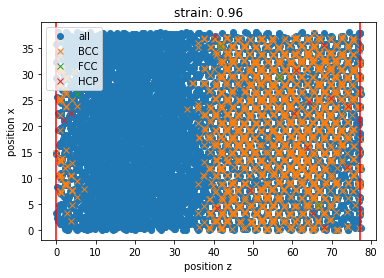

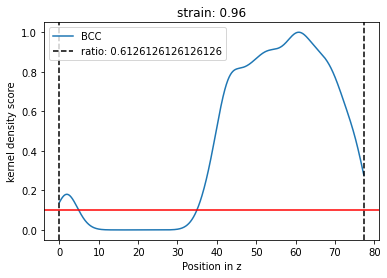

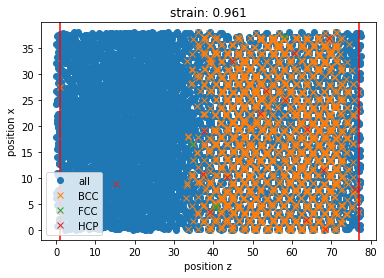

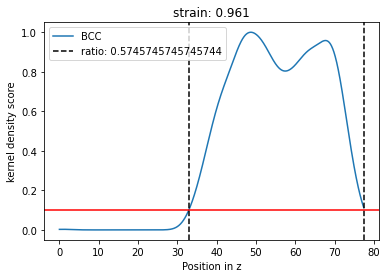

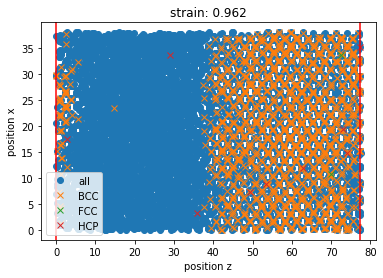

...

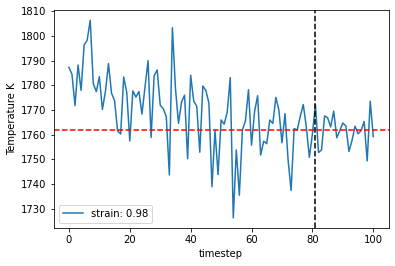

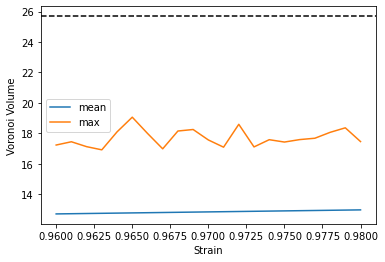

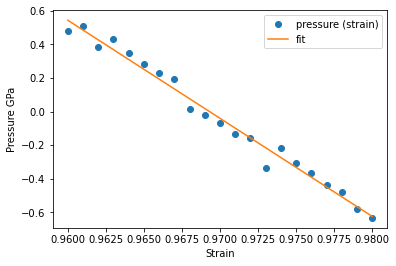

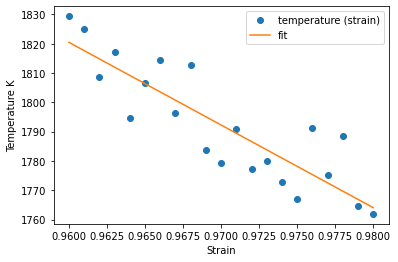

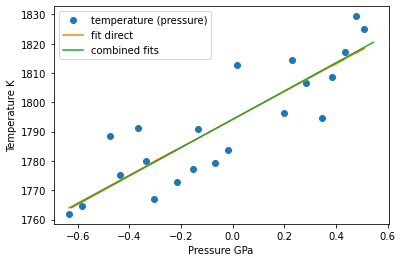

1794.1714822556612 1794.1988218712115
1794.1714822556612 1795.649011365663 1778.7777811464105 1812.5202415849155
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1794.1714822556612, 'center': 0.97}


In [36]:
temperature_estimate_lst, temperature_calculated_lst = [], []
while len(temperature_calculated_lst) < 3 or not convergence_goal_achieved and len(temperature_calculated_lst) < 10:
    temperature_estimate_lst.append(temperature_next)
    temperature_next, temperature_mean, temperature_left, temperature_right, strain_result_lst, pressure_result_lst = calc_temp_iteration(
        basis=ham_minimize_vol.get_structure().repeat([1,1,2]), 
        temperature_next=temperature_next, 
        project_parameter=project_parameter,
        timestep=timestep,
        nve_run_time_steps=nve_run_time_steps, 
        fit_range=fit_range,  
        center=center,
        debug_plot=True)
    print(temperature_next, temperature_mean, temperature_left, temperature_right)
    output = validate_convergence(pr=pr,
                                  temperature_left=temperature_left, 
                                  temperature_next=temperature_next, 
                                  temperature_right=temperature_right, 
                                  enable_iteration=enable_iteration,
                                  timestep_iter=timestep_iter,
                                  timestep_lst=project_parameter['timestep_lst'],
                                  timestep=timestep,
                                  fit_range_iter=fit_range_iter, 
                                  fit_range_lst=project_parameter['fit_range_lst'], 
                                  fit_range=fit_range, 
                                  nve_run_time_steps_iter=nve_run_time_steps_iter, 
                                  nve_run_time_steps_lst=project_parameter['nve_run_time_steps_lst'], 
                                  nve_run_time_steps=nve_run_time_steps,
                                  strain_result_lst=strain_result_lst, 
                                  pressure_result_lst=pressure_result_lst, 
                                  step_count=step_count, 
                                  step_dict=step_dict, 
                                  boundary_value=project_parameter['boundary_value'], 
                                  ratio_boundary=project_parameter['ratio_boundary'],
                                  convergence_goal=project_parameter['convergence_criterion'],
                                  output_file=output_file)
    convergence_goal_achieved, enable_iteration, step_count, step_dict, timestep, fit_range, nve_run_time_steps, boundary_value, ratio_boundary, temperature_next, center = output
    print(step_dict[step_count])
    temperature_calculated_lst.append(temperature_next)

In [37]:
if not os.path.exists(output_file):
    with open(output_file, 'w') as f:
        json.dump(step_dict, f)

In [38]:
step_dict

{0: {'temperature_next': 1727},
 1: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1802.5147857215081,
  'center': 0.95},
 2: {'timestep': 2,
  'fit_range': 0.01,
  'nve_run_time_steps': 20000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1796.9930971721303,
  'center': 0.97},
 3: {'timestep': 1,
  'fit_range': 0.01,
  'nve_run_time_steps': 50000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1794.4524012412219,
  'center': 0.97},
 4: {'timestep': 1,
  'fit_range': 0.01,
  'nve_run_time_steps': 50000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1791.2727524102718,
  'center': 0.96},
 5: {'timestep': 1,
  'fit_range': 0.01,
  'nve_run_time_steps': 50000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1794.3596870654974,
  'center': 0.97},
 6: {'timestep': 1,
  'fit_range': 0.01,
  

findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


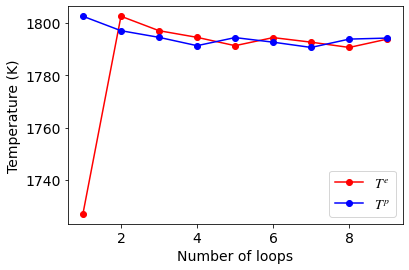

In [39]:
#plot the convergence of loop calculations
first_key = list(step_dict.keys())[-1]
second_key = 'temperature_next'
allt = [step_dict[key][second_key] for key in list(step_dict.keys())]
plt.plot(np.arange(1, len(allt)), allt[0:-1], 'ro-', label=r"$T^e$")
plt.plot(np.arange(1, len(allt)), allt[1:], 'bo-', label=r"$T^p$")
plt.legend(fontsize=14)
plt.tick_params(axis='both', labelsize=14)
plt.xlabel('Number of loops', fontsize=14)
plt.ylabel('Temperature (K)', fontsize=14)
plt.show()

In [40]:
df = pr.job_table()
df

,id,status,chemicalformula,job,subjob,projectpath,project,timestart,timestop,totalcputime,computer,hamilton,hamversion,parentid,masterid
0,1,finished,Fe4394,minimize_pos,/minimize_pos,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-04 07:29:35.086371,2020-05-04 07:29:37.649819,2.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,NaN,None
1,2,finished,Fe4394,minimize_vol,/minimize_vol,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-04 07:29:38.957285,2020-05-04 07:29:39.720252,0.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,NaN,None
2,3,finished,Fe4394,temp_heating_1000,/temp_heating_1000,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-04 07:29:41.021858,2020-05-04 07:29:44.785957,3.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,NaN,None
3,4,finished,Fe4394,temp_heating_2000,/temp_heating_2000,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-04 07:29:46.033293,2020-05-04 07:29:49.854966,3.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,NaN,None
4,5,finished,Fe4394,temp_heating_1500_0,/temp_heating_1500_0,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-04 07:29:51.094684,2020-05-04 07:29:54.958321,3.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
411,412,finished,Fe8788,ham_nve_0_976_1793_78_2,/ham_nve_0_976_1793_78_2,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-05 01:42:10.610205,2020-05-05 01:47:06.422175,295.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,391.0,None
412,413,finished,Fe8788,ham_nve_0_977_1793_78_2,/ham_nve_0_977_1793_78_2,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-05 01:47:08.723579,2020-05-05 01:51:59.989155,291.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,392.0,None
413,414,finished,Fe8788,ham_nve_0_978_1793_78_2,/ham_nve_0_978_1793_78_2,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-05 01:52:02.283329,2020-05-05 01:56:54.790076,292.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,393.0,None
414,415,finished,Fe8788,ham_nve_0_979_1793_78_2,/ham_nve_0_979_1793_78_2,/scratch/janssen/pyiron_meltingpoint_fe/,melting/,2020-05-05 01:56:57.066763,2020-05-05 02:01:48.192154,291.0,pyiron@cmpc08.mpie.de#8,Lammps,0.1,394.0,None
